In [1]:
# example of training a gan on mnist
from numpy import expand_dims
from numpy import zeros
from numpy import ones
from numpy import vstack
from numpy.random import randn
from numpy.random import randint
import numpy as np
from tensorflow.keras.optimizers import Adam
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Reshape
from keras.layers import Flatten
from keras.layers import Conv2D
from keras.layers import Conv2DTranspose
from keras.layers import LeakyReLU
from keras.layers import Dropout
from matplotlib import pyplot
import os
import pandas as pd
import math
import plotly.express as px
%matplotlib inline 
from matplotlib import pyplot as plt

In [2]:
# define the standalone discriminator model
def define_discriminator(in_shape=(11,128,1)):
    model = Sequential()
    model.add(Conv2D(64, (3,3), strides=(2, 2), padding='same', input_shape=in_shape))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Dropout(0.4))
    model.add(Conv2D(64, (3,3), strides=(2, 2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Dropout(0.4))
    model.add(Flatten())
    model.add(Dense(1, activation='sigmoid'))
    # compile model
    opt = Adam(lr=0.0002, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
    return model

In [3]:
# define the standalone generator model

#ToDo
# get output to match 11x128
def define_generator(latent_dim):
    model = Sequential()
    # original->128 * 7 * 7 ist dann 1/4 des originalbildes in dem fall 28x28 auf 128 Bilder,
    # desewegen 128*7*7 nodes. Wir verkleinern einfach die länge, sonst werden die sensoren weggeworfen..
    # 2558,11,128 ZU 2558,11,32 -> 128/4
    n_nodes = 500 * 11 * 32   
    model.add(Dense(n_nodes, input_dim=latent_dim))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Reshape((11, 32, 500)))
    # upsample
    model.add(Conv2DTranspose(500, (2,2), strides=(1,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    # upsample
    model.add(Conv2DTranspose(500, (2,2), strides=(1,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Conv2D(1, (7,7), activation='sigmoid', padding='same'))
    return model

In [4]:
# define the combined generator and discriminator model, for updating the generator
def define_gan(g_model, d_model):
    # make weights in the discriminator not trainable
    d_model.trainable = False
    # connect them
    model = Sequential()
    # add generator
    model.add(g_model)
    # add the discriminator
    model.add(d_model)
    # compile model
    opt = Adam(learning_rate=0.0002, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=opt)
    return model

# LOAD REAL DATA

In [5]:
def plot_raw_data(X):
    for i in range (int(X.shape[0])):
        plt.imshow(X[i,:,:])
        plt.show()

In [6]:
# load and prepare mnist training images
def load_real_samples(path_sensor):
    directory = os.fsencode(path_sensor)
    X = []
    
    for file in os.listdir(directory):
        filename = os.fsdecode(file)
        print('Loading File:', filename)
        if not filename == 'sleep_staging.csv':
            x = pd.read_csv(path_sensor+'/'+filename).to_numpy()
            X.append(x[:,0])
            
    X = np.asarray(X)
    print('all data raw',X.shape) #(11, 327310)
    # Split Data in Images (Size: 128x11)
    # get length to be able to split in 128 wide images (lenght needs to be dividable trough 128)
    wanted_length = int(X.shape[1]/128) + 1
    padding = wanted_length * 128
    # Add np.zeros add padding
    result = np.zeros((X.shape[0], padding))
    # insert data in zeros array
    result[:X.shape[0],:X.shape[1]] = X
    X = result
    # split array in 128 samples by batch/image
    X = np.split(X, 128, axis=-1)
    # convert tp np.array
    X = np.asarray(X)
    # get right dimensions
    X = np.transpose(X)
    print('data splitted and transposed',X.shape) #(2558, 11, 128)
    # get 500 samples because dataset way too big...
    X = X[1500:2000,:]
    print('n sized sample of data',X.shape) #(500, 11, 128)
    # expand dimension to get 1 channel image
    X = expand_dims(X, axis=-1)
    # plot data OPTIONAL BECAUSE ITS LOOOOOOOONG AF
    #plot_raw_data(X)
    return X

#path_sensor = '../data/Exercises_SS22/sleeplab_dataset_10hz/patient_29_male_7_years'
#load_real_samples(path_sensor)

# CREATE BATCHES OF REAL DATA eg. 100x11
NEED TO CREATE N IMAGES FROM THE 300k SAMPLE VALUES!

In [7]:
# select real samples
def generate_real_samples(dataset, n_samples):
    # choose random instances
    ix = randint(0, dataset.shape[0], n_samples)
    # retrieve selected images
    X = dataset[ix]
    #print('SHAPE OF REAL DATA:',X.shape)
    # generate 'real' class labels (1)
    y = ones((n_samples, 1))
    return X, y

In [8]:
# generate points in latent space as input for the generator
def generate_latent_points(latent_dim, n_samples):
    #print('func: generate_latent_points', latent_dim, n_samples)
    # generate points in the latent space
    x_input = randn(latent_dim * n_samples)
    #print('x_input:', x_input.shape) #64000
    # reshape into a batch of inputs for the network
    x_input = x_input.reshape(n_samples, latent_dim)
    #print('x_input:', x_input.shape) #64,100
    return x_input

In [9]:
def plot_fake(X):
    for i in range(int(X.shape[0])):
        plt.imshow(X[i])
        plt.show()

In [10]:
# use the generator to generate n fake examples, with class labels
def generate_fake_samples(g_model, latent_dim, n_samples):
    #print('func: generate_fake_samples')
    # generate points in latent space
    x_input = generate_latent_points(latent_dim, n_samples)
    # predict outputs
    #print('model predict with x_input')
    X = g_model.predict(x_input)
    #print('model predicted')
    # create 'fake' class labels (0)
    y = zeros((n_samples, 1))
    return X, y

In [11]:
# create and save a plot of generated images (reversed grayscale)
def save_plot(examples, epoch, n=10):
    # plot images
    for i in range(n * n):
        # define subplot
        pyplot.subplot(n, n, 1 + i)
        # turn off axis
        pyplot.axis('off')
        # plot raw pixel data
        pyplot.imshow(examples[i, :, :, 0], cmap='gray_r')
    # save plot to file
    filename = 'generated_plot_e%03d.png' % (epoch+1)
    pyplot.savefig(filename)
    pyplot.close()

In [12]:
# evaluate the discriminator, plot generated images, save generator model
def summarize_performance(epoch, g_model, d_model, dataset, latent_dim, n_samples=100):
    # prepare real samples
    X_real, y_real = generate_real_samples(dataset, n_samples)
    plot_fake(X_real)
    # evaluate discriminator on real examples
    _, acc_real = d_model.evaluate(X_real, y_real, verbose=0)
    # prepare fake examples
    x_fake, y_fake = generate_fake_samples(g_model, latent_dim, n_samples)
    plot_fake(x_fake)
    # evaluate discriminator on fake examples
    _, acc_fake = d_model.evaluate(x_fake, y_fake, verbose=0)
    # summarize discriminator performance
    print('>Accuracy real: %.0f%%, fake: %.0f%%' % (acc_real*100, acc_fake*100))
    # save plot
    save_plot(x_fake, epoch)
    # save the generator model tile file
    filename = 'generator_model_%03d.h5' % (epoch + 1)
    g_model.save(filename)

In [13]:
# train the generator and discriminator
def train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs=100, n_batch=128):
    bat_per_epo = int(dataset.shape[0] / n_batch)
    half_batch = int(n_batch / 2)
    # manually enumerate epochs
    for i in range(n_epochs):
        # enumerate batches over the training set
        for j in range(bat_per_epo):
            # get randomly selected 'real' samples
            #print('get real samples')
            X_real, y_real = generate_real_samples(dataset, half_batch)
            # generate 'fake' examples
            #print('get fake samples')
            X_fake, y_fake = generate_fake_samples(g_model, latent_dim, half_batch)
            # create training set for the discriminator
            #print('shape of reaal and fake data', X_real.shape, X_fake.shape)
            X, y = vstack((X_real, X_fake)), vstack((y_real, y_fake))
            # update discriminator model weights
            #print('train diskriminator')
            d_loss, _ = d_model.train_on_batch(X, y)
            # prepare points in latent space as input for the generator
            #print('generate latent points')
            X_gan = generate_latent_points(latent_dim, n_batch)
            # create inverted labels for the fake samples
            #print('generate y for fake')
            y_gan = ones((n_batch, 1))
            # update the generator via the discriminator's error
            #print('train gan model')
            g_loss = gan_model.train_on_batch(X_gan, y_gan)
            # summarize loss on this batch
            print('>%d, %d/%d, d=%.3f, g=%.3f' % (i+1, j+1, bat_per_epo, d_loss, g_loss))
        # evaluate the model performance, sometimes
        if (i+1) % 10 == 0:
            summarize_performance(i, g_model, d_model, dataset, latent_dim)

2022-07-04 19:43:32.759703: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2022-07-04 19:43:32.759805: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
/Users/manuel/miniforge3/envs/tensorflow/lib/python3.8/site-packages/keras/optimizer_v2/adam.py:105: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


Metal device set to: Apple M1 Pro
Loading File: REOGM1_10HZ.csv
Loading File: O1M2_10HZ.csv
Loading File: BeinLi_10HZ.csv
Loading File: LEOGM2_10HZ.csv
Loading File: F3M2_10HZ.csv
Loading File: O2M1_10HZ.csv
Loading File: BeinRe_10HZ.csv
Loading File: C3M2_10HZ.csv
Loading File: F4M1_10HZ.csv
Loading File: C4M1_10HZ.csv
Loading File: EMG_10HZ.csv
Loading File: sleep_staging.csv
all data raw (11, 327310)
data splitted and transposed (2558, 11, 128)
n sized sample of data (500, 11, 128)


2022-07-04 19:43:33.219069: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2022-07-04 19:43:33.264396: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2022-07-04 19:43:34.019492: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2022-07-04 19:43:34.368859: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


>1, 1/3, d=0.957, g=0.663
>1, 2/3, d=0.606, g=0.652
>1, 3/3, d=0.510, g=0.645
>2, 1/3, d=0.449, g=0.641
>2, 2/3, d=0.399, g=0.639
>2, 3/3, d=0.422, g=0.639
>3, 1/3, d=0.426, g=0.638
>3, 2/3, d=0.379, g=0.640
>3, 3/3, d=0.375, g=0.642
>4, 1/3, d=0.379, g=0.644
>4, 2/3, d=0.374, g=0.646
>4, 3/3, d=0.373, g=0.648
>5, 1/3, d=0.374, g=0.650
>5, 2/3, d=0.408, g=0.653
>5, 3/3, d=0.367, g=0.660
>6, 1/3, d=0.375, g=0.667
>6, 2/3, d=0.407, g=0.670
>6, 3/3, d=0.361, g=0.674
>7, 1/3, d=0.359, g=0.680
>7, 2/3, d=0.354, g=0.686
>7, 3/3, d=0.384, g=0.688
>8, 1/3, d=0.352, g=0.692
>8, 2/3, d=0.357, g=0.694
>8, 3/3, d=0.350, g=0.697
>9, 1/3, d=0.347, g=0.700
>9, 2/3, d=0.347, g=0.703
>9, 3/3, d=0.346, g=0.705
>10, 1/3, d=0.346, g=0.704
>10, 2/3, d=0.350, g=0.699
>10, 3/3, d=0.384, g=0.688


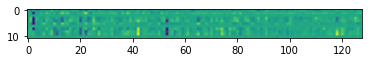

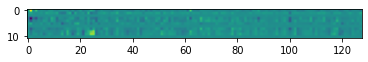

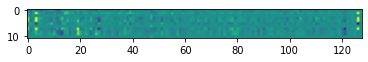

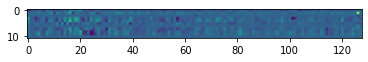

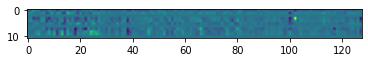

...

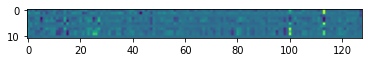

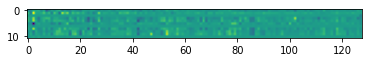

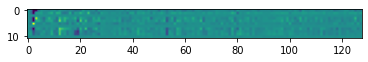

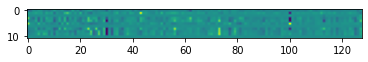

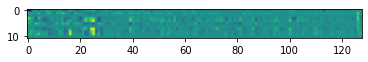

2022-07-04 19:44:40.827997: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2022-07-04 19:44:40.941661: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


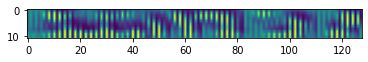

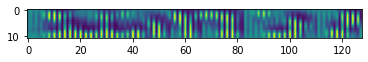

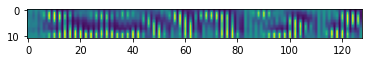

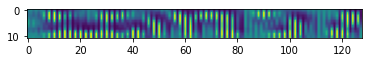

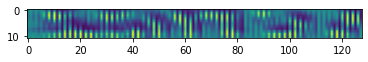

...

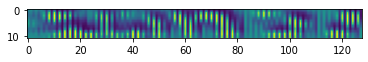

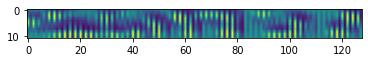

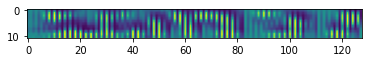

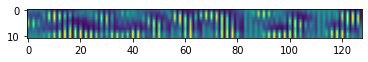

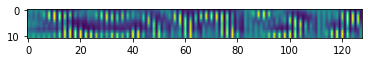

>Accuracy real: 100%, fake: 2%
>11, 1/3, d=0.356, g=0.680
>11, 2/3, d=0.373, g=0.668
>11, 3/3, d=0.369, g=0.659
>12, 1/3, d=0.381, g=0.650
>12, 2/3, d=0.375, g=0.644
>12, 3/3, d=0.415, g=0.638
>13, 1/3, d=0.385, g=0.633
>13, 2/3, d=0.386, g=0.629
>13, 3/3, d=0.386, g=0.626
>14, 1/3, d=0.386, g=0.624
>14, 2/3, d=0.388, g=0.625
>14, 3/3, d=0.385, g=0.626
>15, 1/3, d=0.385, g=0.630
>15, 2/3, d=0.382, g=0.630
>15, 3/3, d=0.419, g=0.634
>16, 1/3, d=0.377, g=0.640
>16, 2/3, d=0.386, g=0.643
>16, 3/3, d=0.370, g=0.649
>17, 1/3, d=0.377, g=0.654
>17, 2/3, d=0.363, g=0.661
>17, 3/3, d=0.370, g=0.668
>18, 1/3, d=0.355, g=0.676
>18, 2/3, d=0.351, g=0.685
>18, 3/3, d=0.347, g=0.692
>19, 1/3, d=0.343, g=0.703
>19, 2/3, d=0.338, g=0.713
>19, 3/3, d=0.334, g=0.723
>20, 1/3, d=0.330, g=0.729
>20, 2/3, d=0.329, g=0.737
>20, 3/3, d=0.322, g=0.746


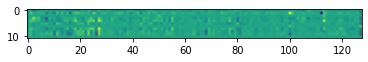

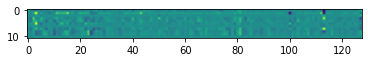

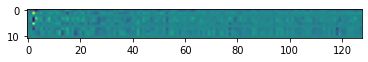

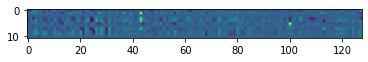

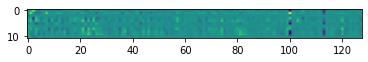

...

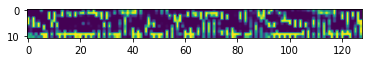

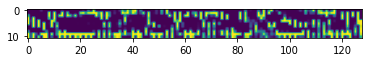

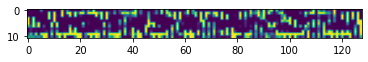

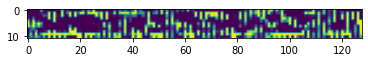

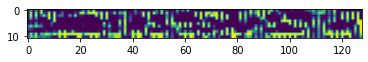

>Accuracy real: 100%, fake: 100%
>21, 1/3, d=0.330, g=0.751
>21, 2/3, d=0.335, g=0.757
>21, 3/3, d=0.312, g=0.767
>22, 1/3, d=0.314, g=0.778
>22, 2/3, d=0.304, g=0.786
>22, 3/3, d=0.328, g=0.787
>23, 1/3, d=0.301, g=0.795
>23, 2/3, d=0.301, g=0.799
>23, 3/3, d=0.309, g=0.801
>24, 1/3, d=0.292, g=0.811
>24, 2/3, d=0.291, g=0.818
>24, 3/3, d=0.287, g=0.827
>25, 1/3, d=0.282, g=0.840
>25, 2/3, d=0.279, g=0.848
>25, 3/3, d=0.277, g=0.856
>26, 1/3, d=0.291, g=0.858
>26, 2/3, d=0.271, g=0.865
>26, 3/3, d=0.269, g=0.876
>27, 1/3, d=0.271, g=0.881
>27, 2/3, d=0.263, g=0.889
>27, 3/3, d=0.258, g=0.903
>28, 1/3, d=0.255, g=0.914
>28, 2/3, d=0.251, g=0.925
>28, 3/3, d=0.265, g=0.930
>29, 1/3, d=0.245, g=0.939
>29, 2/3, d=0.243, g=0.949
>29, 3/3, d=0.246, g=0.959
>30, 1/3, d=0.236, g=0.970
>30, 2/3, d=0.234, g=0.982
>30, 3/3, d=0.229, g=0.994


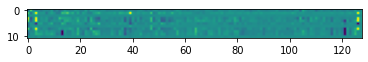

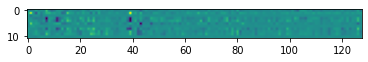

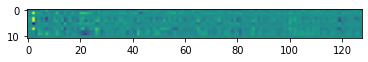

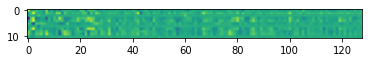

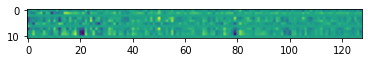

...

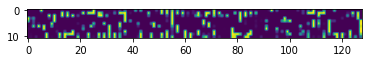

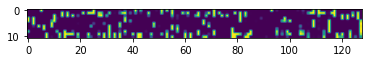

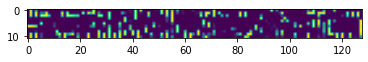

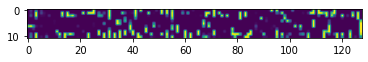

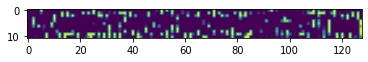

>Accuracy real: 100%, fake: 100%
>31, 1/3, d=0.226, g=1.005
>31, 2/3, d=0.223, g=1.019
>31, 3/3, d=0.220, g=1.032
>32, 1/3, d=0.216, g=1.046
>32, 2/3, d=0.211, g=1.059
>32, 3/3, d=0.209, g=1.072
>33, 1/3, d=0.205, g=1.086
>33, 2/3, d=0.202, g=1.098
>33, 3/3, d=0.207, g=1.107
>34, 1/3, d=0.195, g=1.120
>34, 2/3, d=0.194, g=1.132
>34, 3/3, d=0.191, g=1.145
>35, 1/3, d=0.187, g=1.161
>35, 2/3, d=0.184, g=1.175
>35, 3/3, d=0.180, g=1.191
>36, 1/3, d=0.177, g=1.207
>36, 2/3, d=0.174, g=1.219
>36, 3/3, d=0.176, g=1.232
>37, 1/3, d=0.171, g=1.245
>37, 2/3, d=0.167, g=1.259
>37, 3/3, d=0.163, g=1.272
>38, 1/3, d=0.175, g=1.280
>38, 2/3, d=0.160, g=1.293
>38, 3/3, d=0.170, g=1.302
>39, 1/3, d=0.155, g=1.316
>39, 2/3, d=0.158, g=1.329
>39, 3/3, d=0.150, g=1.348
>40, 1/3, d=0.147, g=1.370
>40, 2/3, d=0.143, g=1.389
>40, 3/3, d=0.140, g=1.407


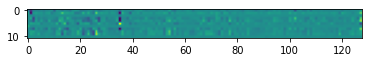

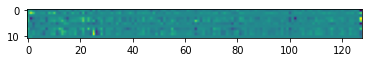

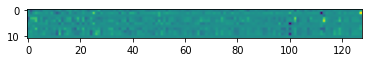

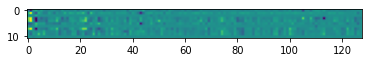

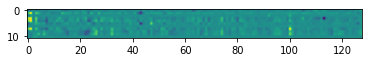

...

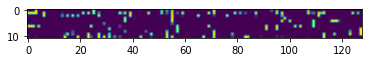

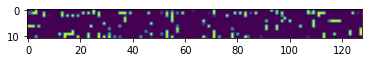

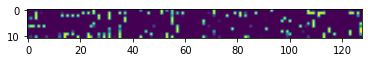

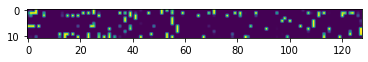

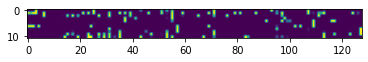

>Accuracy real: 100%, fake: 100%
>41, 1/3, d=0.137, g=1.430
>41, 2/3, d=0.133, g=1.452
>41, 3/3, d=0.130, g=1.475
>42, 1/3, d=0.127, g=1.497
>42, 2/3, d=0.124, g=1.516
>42, 3/3, d=0.120, g=1.539
>43, 1/3, d=0.118, g=1.562
>43, 2/3, d=0.115, g=1.586
>43, 3/3, d=0.112, g=1.608
>44, 1/3, d=0.115, g=1.627
>44, 2/3, d=0.108, g=1.642
>44, 3/3, d=0.104, g=1.666
>45, 1/3, d=0.102, g=1.686
>45, 2/3, d=0.100, g=1.712
>45, 3/3, d=0.099, g=1.732
>46, 1/3, d=0.095, g=1.756
>46, 2/3, d=0.092, g=1.779
>46, 3/3, d=0.090, g=1.802
>47, 1/3, d=0.087, g=1.828
>47, 2/3, d=0.107, g=1.840
>47, 3/3, d=0.084, g=1.861
>48, 1/3, d=0.082, g=1.884
>48, 2/3, d=0.080, g=1.908
>48, 3/3, d=0.078, g=1.933
>49, 1/3, d=0.083, g=1.951
>49, 2/3, d=0.074, g=1.974
>49, 3/3, d=0.073, g=1.998
>50, 1/3, d=0.071, g=2.022
>50, 2/3, d=0.069, g=2.047
>50, 3/3, d=0.067, g=2.072


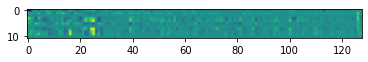

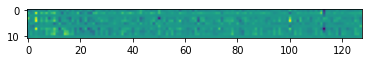

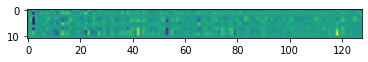

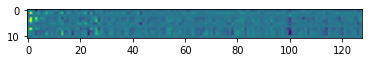

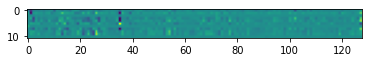

...

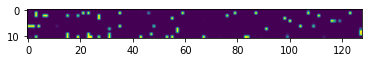

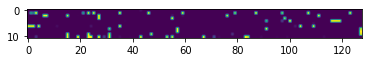

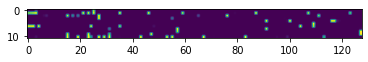

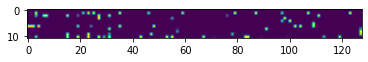

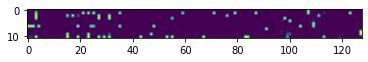

>Accuracy real: 100%, fake: 100%
>51, 1/3, d=0.065, g=2.097
>51, 2/3, d=0.063, g=2.124
>51, 3/3, d=0.062, g=2.147
>52, 1/3, d=0.060, g=2.174
>52, 2/3, d=0.059, g=2.198
>52, 3/3, d=0.057, g=2.221
>53, 1/3, d=0.056, g=2.244
>53, 2/3, d=0.054, g=2.267
>53, 3/3, d=0.053, g=2.291
>54, 1/3, d=0.052, g=2.316
>54, 2/3, d=0.050, g=2.340
>54, 3/3, d=0.049, g=2.366
>55, 1/3, d=0.050, g=2.386
>55, 2/3, d=0.047, g=2.408
>55, 3/3, d=0.047, g=2.429
>56, 1/3, d=0.045, g=2.452
>56, 2/3, d=0.043, g=2.476
>56, 3/3, d=0.044, g=2.496
>57, 1/3, d=0.041, g=2.519
>57, 2/3, d=0.040, g=2.542
>57, 3/3, d=0.039, g=2.566
>58, 1/3, d=0.038, g=2.591
>58, 2/3, d=0.037, g=2.616
>58, 3/3, d=0.037, g=2.641
>59, 1/3, d=0.036, g=2.663
>59, 2/3, d=0.035, g=2.686
>59, 3/3, d=0.034, g=2.709
>60, 1/3, d=0.033, g=2.732
>60, 2/3, d=0.032, g=2.756
>60, 3/3, d=0.032, g=2.779


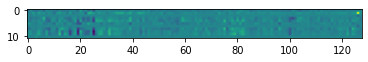

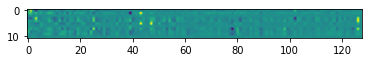

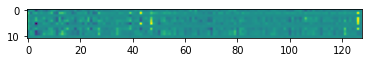

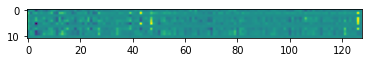

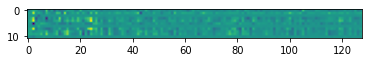

...

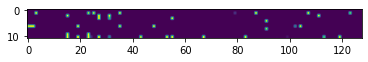

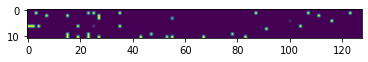

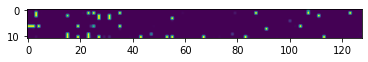

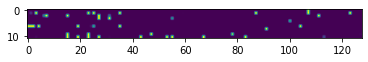

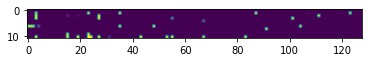

>Accuracy real: 100%, fake: 100%
>61, 1/3, d=0.031, g=2.803
>61, 2/3, d=0.101, g=2.793
>61, 3/3, d=0.030, g=2.800
>62, 1/3, d=0.030, g=2.814
>62, 2/3, d=0.030, g=2.832
>62, 3/3, d=0.029, g=2.853
>63, 1/3, d=0.028, g=2.875
>63, 2/3, d=0.029, g=2.894
>63, 3/3, d=0.027, g=2.914
>64, 1/3, d=0.027, g=2.936
>64, 2/3, d=0.026, g=2.958
>64, 3/3, d=0.026, g=2.980
>65, 1/3, d=0.025, g=3.002
>65, 2/3, d=0.024, g=3.023
>65, 3/3, d=0.024, g=3.046
>66, 1/3, d=0.023, g=3.067
>66, 2/3, d=0.023, g=3.088
>66, 3/3, d=0.022, g=3.110
>67, 1/3, d=0.022, g=3.130
>67, 2/3, d=0.021, g=3.150
>67, 3/3, d=0.021, g=3.171
>68, 1/3, d=0.021, g=3.191
>68, 2/3, d=0.115, g=3.173
>68, 3/3, d=0.020, g=3.173
>69, 1/3, d=0.020, g=3.184
>69, 2/3, d=0.020, g=3.198
>69, 3/3, d=0.020, g=3.216
>70, 1/3, d=0.020, g=3.235
>70, 2/3, d=0.019, g=3.254
>70, 3/3, d=0.019, g=3.273


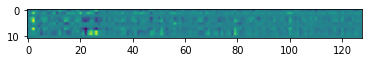

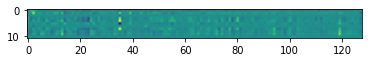

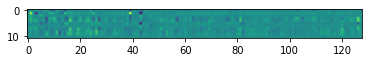

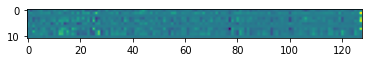

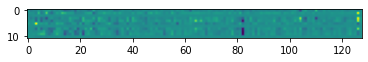

...

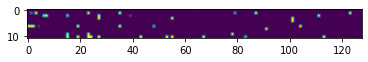

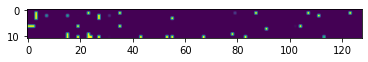

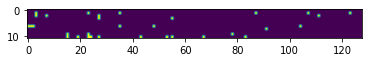

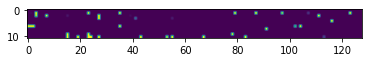

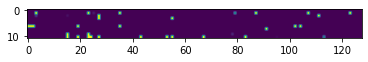

>Accuracy real: 100%, fake: 100%
>71, 1/3, d=0.018, g=3.293
>71, 2/3, d=0.018, g=3.311
>71, 3/3, d=0.018, g=3.332
>72, 1/3, d=0.017, g=3.350
>72, 2/3, d=0.017, g=3.369
>72, 3/3, d=0.017, g=3.389
>73, 1/3, d=0.016, g=3.407
>73, 2/3, d=0.016, g=3.427
>73, 3/3, d=0.016, g=3.443
>74, 1/3, d=0.015, g=3.462
>74, 2/3, d=0.015, g=3.480
>74, 3/3, d=0.015, g=3.498
>75, 1/3, d=0.015, g=3.516
>75, 2/3, d=0.014, g=3.533
>75, 3/3, d=0.014, g=3.552
>76, 1/3, d=0.014, g=3.569
>76, 2/3, d=0.014, g=3.587
>76, 3/3, d=0.013, g=3.604
>77, 1/3, d=0.013, g=3.621
>77, 2/3, d=0.013, g=3.637
>77, 3/3, d=0.013, g=3.654
>78, 1/3, d=0.013, g=3.671
>78, 2/3, d=0.012, g=3.686
>78, 3/3, d=0.012, g=3.702
>79, 1/3, d=0.012, g=3.719


Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x169daf380>
    label = <none> 
    device = <AGXG13XDevice: 0x13e081000>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x1198e4c00>
        label = <none> 
        device = <AGXG13XDevice: 0x13e081000>
            name = Apple M1 Pro 
    retainedReferences = 1


In [ ]:
# define path
path_sensor = '../data/Exercises_SS22/sleeplab_dataset_10hz/patient_29_male_7_years'
# size of the latent space
latent_dim = 10
# create the discriminator
d_model = define_discriminator()
# create the generator
g_model = define_generator(latent_dim)
# create the gan
gan_model = define_gan(g_model, d_model)
# load image data
dataset = load_real_samples(path_sensor)
# train model
train(g_model, d_model, gan_model, dataset, latent_dim)

In [ ]:
model = Sequential()
# foundation for 7x7 image
# original->128 * 7 * 7 ist dann 1/4 des originalbildes in dem fall 28x28 auf 128 Bilder,
# desewegen 128*7*7 nodes. Wir verkleinern einfach die länge, sonst werden die sensoren weggeworfen..
# 2558,11,128 ZU 2558,11,32 -> 128/4
n_nodes = 500 * 11 * 32   
model.add(Dense(n_nodes, input_dim=10))
model.add(LeakyReLU(alpha=0.2))
model.add(Reshape((11, 32, 500)))   # original->7 * 7 * 128
print(model.output_shape)
# upsample to x,x ---14x14---
model.add(Conv2DTranspose(500, (2,2), strides=(1,2), padding='same'))
print(model.output_shape)
model.add(LeakyReLU(alpha=0.2))
# upsample to x,x ---28x28---
model.add(Conv2DTranspose(500, (2,2), strides=(1,2), padding='same'))
print(model.output_shape)
model.add(LeakyReLU(alpha=0.2))
model.add(Conv2D(1, (7,7), activation='sigmoid', padding='same'))
print(model.output_shape)

In [ ]:
# OLD GENERATOR1

#ToDo
# get output to match 11x128
#def define_generator(latent_dim):
#    model = Sequential()
#    # foundation for 7x7 image
#    # original->128 * 7 * 7 ist dann 1/4 des originalbildes in dem fall 28x28 auf 128 Bilder,
#    # desewegen 128*7*7 nodes. Wir verkleinern einfach die länge, sonst werden die sensoren weggeworfen..
#    # 2558,11,128 ZU 2558,11,32 -> 128/4
#    n_nodes = 2558 * 11 * 32   model.add(Dense(n_nodes, input_dim=latent_dim))
#    model.add(LeakyReLU(alpha=0.2))
#    model.add(Reshape((32, 11, 2558)))   # original->7 * 7 * 128
#    # upsample to x,x ---14x14---
#    model.add(Conv2DTranspose(2558, (1,2), strides=(2,2), padding='same'))
#    model.add(LeakyReLU(alpha=0.2))
#    # upsample to x,x ---28x28---
#    model.add(Conv2DTranspose(2558, (1,2), strides=(2,2), padding='same'))
#    model.add(LeakyReLU(alpha=0.2))
#    model.add(Conv2D(1, (7,7), activation='sigmoid', padding='same'))
#    return model

In [ ]:
in_shape=(128,11,1)
model = Sequential()
model.add(Conv2D(64, (3,3), strides=(2, 2), padding='same', input_shape=in_shape))
print(model.output_shape)
model.add(LeakyReLU(alpha=0.2))
model.add(Dropout(0.4))
model.add(Conv2D(64, (3,3), strides=(2, 2), padding='same'))
print(model.output_shape)
model.add(LeakyReLU(alpha=0.2))
model.add(Dropout(0.4))
model.add(Flatten())
model.add(Dense(1, activation='sigmoid'))
print(model.output_shape)